# Multi-slice Ptychography Attempt

### Acknowledgements

This tutorial was adapted from "Ptychography_02.ipynb" by the py4DSTEM `phase_contrast` team:
- Steven Zeltmann (steven.zeltmann@lbl.gov)
- Georgios Varnavides (gvarnavides@berkeley.edu)
- Stephanie Ribet (sribet@lbl.gov)
- Colin Ophus (clophus@lbl.gov)

Last updated 2025 June 11

In [5]:
import numpy as np
import py4DSTEM

import matplotlib.pyplot as plt

from py4DSTEM.process.phase.utils import get_array_module

print(py4DSTEM.__version__)


0.14.18


In [3]:
path = 'C:\\_Data\\wendy_data\\'
al2_partial = path + 'al2_dataset_masked_partial_loc10_w40.h5'
probe_path = path + '2D_probe.h5'

In [4]:
dataset = py4DSTEM.read(al2_partial)
probe = py4DSTEM.read(probe_path)

dataset_masked = py4DSTEM.read(path+'processed_al2.h5')
probe_nparray = probe.data

In [4]:
probe

VirtualDiffraction( A 2-dimensional array of shape (192, 192) called 'dp_mean',
                    with dimensions:

                        dim0 = [0,1,2,...] pixels
                        dim1 = [0,1,2,...] pixels
)

In [6]:
dataset

DataCube( A 4-dimensional array of shape (40, 40, 192, 192) called 'datacube',
          with dimensions:

              Rx = [0.0,0.34555085515441486,0.6911017103088297,...] A
              Ry = [0.0,0.34555085515441486,0.6911017103088297,...] A
              Qx = [0.0,0.45449762893741413,0.9089952578748283,...] mrad
              Qy = [0.0,0.45449762893741413,0.9089952578748283,...] mrad
)

In [ ]:
import datetime

def now_str():
    return datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%S")

## Multi Slice

In [ ]:


ptycho1 = py4DSTEM.process.phase.MultislicePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=0,
    vacuum_probe_intensity=probe.data,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
    semiangle_cutoff = 30,
    num_slices=5,
    slice_thicknesses=150,
    
)

ptycho = ptycho1.preprocess(
    plot_rotation=True,
    plot_center_of_mass = True,
    plot_probe_overlaps = True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
    max_batch_size= 128, # set max batch size for GPU memory
    clear_fft_cache=True, # clear the FFT cache to free GPU memory
    force_com_rotation = -1,
)
ptycho00 = ptycho.reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
    fix_probe = False,

).visualize(
)
ptycho.show_fourier_probe()

Calculating center of mass: 100%|██████████| 1600/1600 [00:00<00:00, 2013.42probe position/s]
Best fit rotation forced to -1 degrees.
Normalizing amplitudes: 100%|██████████| 1600/1600 [00:39<00:00, 40.24probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe:   0%|          | 0/64 [00:00<?, ? iter/s]

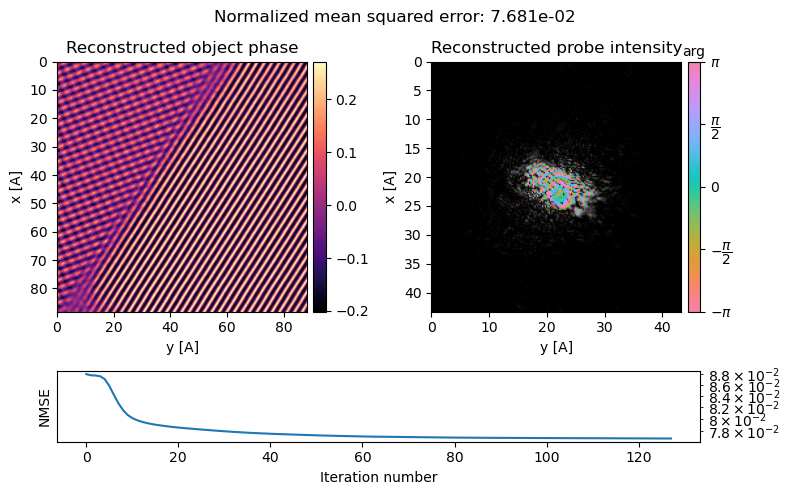

In [ ]:
ptycho00.visualize()
plt.savefig('..\\pictures\\' + 'ptycho00.png', dpi=300)

Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3329.53probe position/s]
Best fit rotation = -7 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:08<00:00, 348.49probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 128 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [59:29<00:00, 27.88s/ iter]


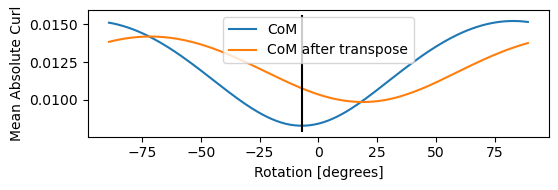

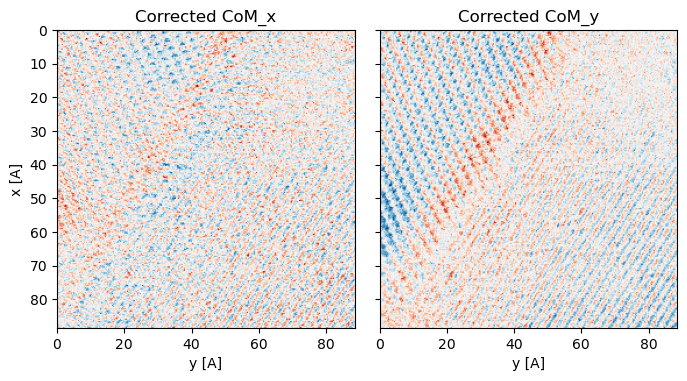

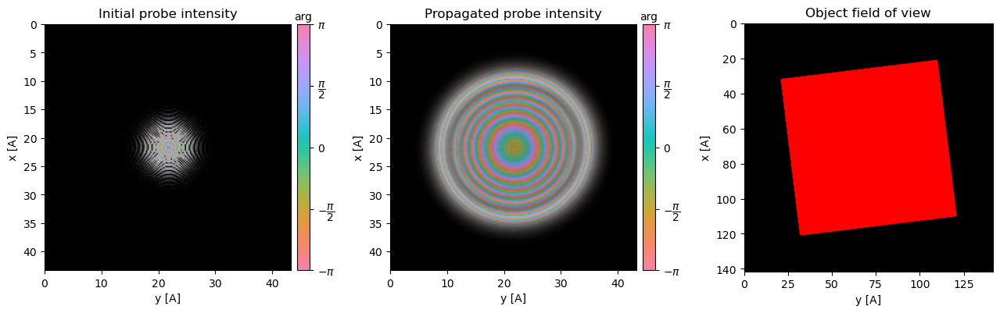

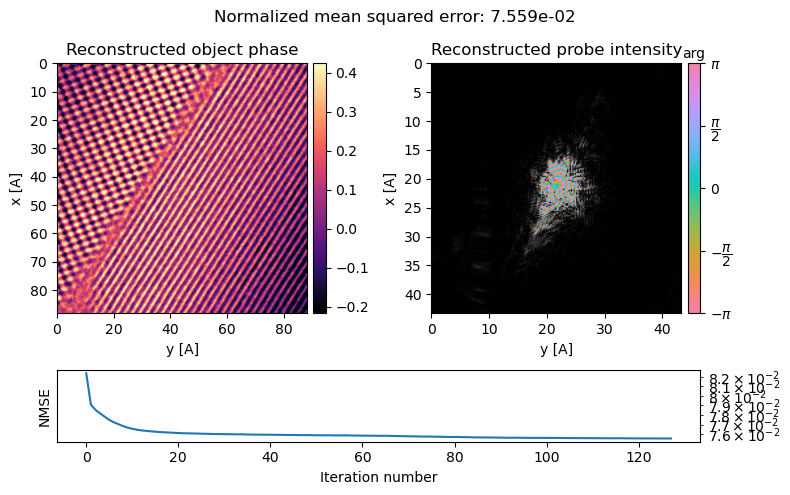

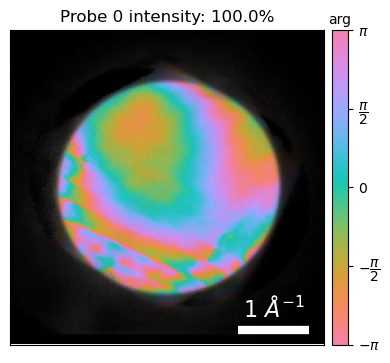

In [ ]:
ptycho1 = py4DSTEM.process.phase.MultislicePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=-5,
    vacuum_probe_intensity=probe_nparray,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
    semiangle_cutoff = 30,
    num_slices=6,
    slice_thicknesses=100,
)

ptycho = ptycho1.preprocess(
    plot_rotation=True,
    plot_center_of_mass = True,
    plot_probe_overlaps = True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
    max_batch_size= 128, # set max batch size for GPU memory
    clear_fft_cache=True, # clear the FFT cache to free GPU memory
)
ptycho00 = ptycho.reconstruct(
    num_iter = 128,
    seed_random=0,
    max_batch_size=128,
    fix_probe = False,

).visualize(
)
plt.savefig('..\\pictures\\' +now_str()+ 'ptycho00_multislice.png', dpi=300)
ptycho.show_fourier_probe()
plt.savefig('..\\pictures\\' +now_str()+ 'ptycho00_multislice_fourier_probe.png', dpi=300)

# ptychos_sweep_roll.append(ptycho00)

# ptychos_object.append( np.angle(ptycho00.object_cropped).copy())
# ptychos_object_fft.append(ptycho00.object_fft)

Continuing reconstruction from previous result. Use reset=True for a fresh start.
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 256 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [47:21<00:00, 22.20s/ iter]


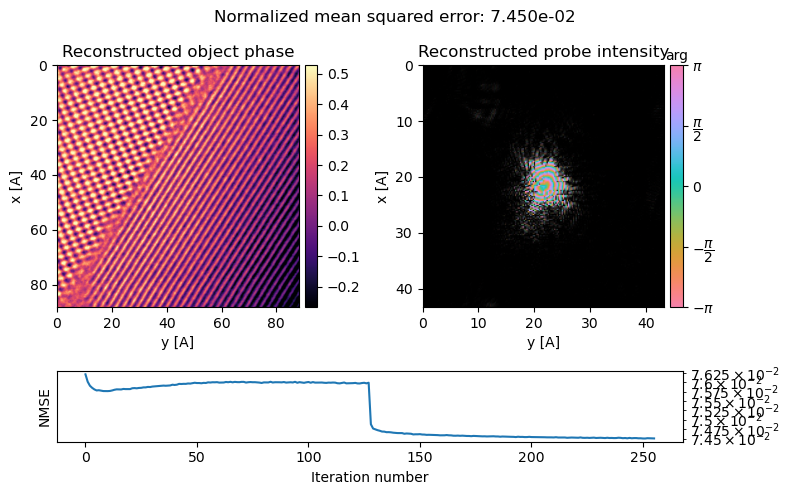

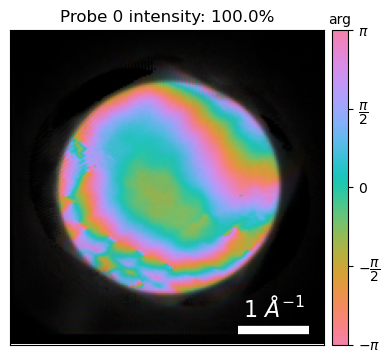

In [ ]:
ptycho00 = ptycho.reconstruct(
    num_iter = 128,
    seed_random=0,
    max_batch_size=256,
    fix_probe = False,

).visualize(
)
plt.savefig('..\\pictures\\' +now_str()+ 'ptycho00_multislice.png', dpi=300)
ptycho.show_fourier_probe()
plt.savefig('..\\pictures\\' +now_str()+ 'ptycho00_multislice_fourier_probe.png', dpi=300)


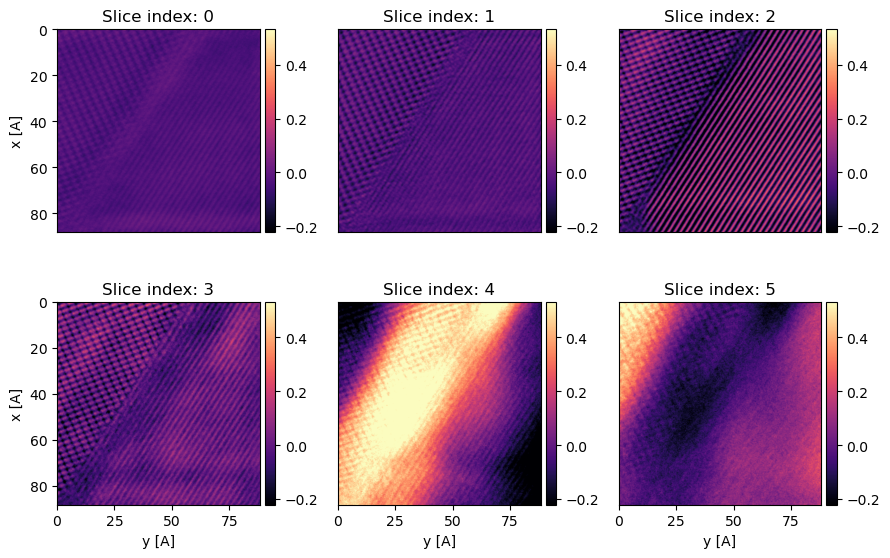

In [ ]:
ptycho00.show_slices()

In [ ]:
image = np.angle(ptycho00.object_cropped).copy()
image = image[:]

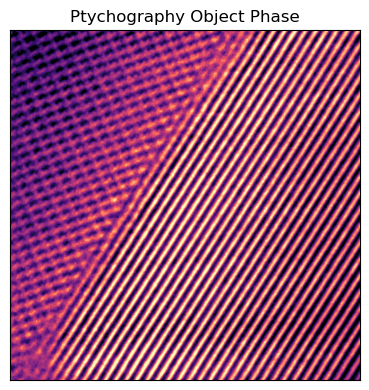

In [ ]:
py4DSTEM.show(
    np.mean(image, axis = 0),
    cmap='magma',
    figsize=(4,4),
    ticks=False,
    title='Ptychography Object Phase',
)

## Manual grid scan with FFT and fourier probe plotting

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 350.85probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:24<00:00,  1.51 iter/s]


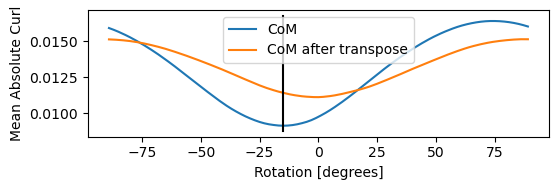

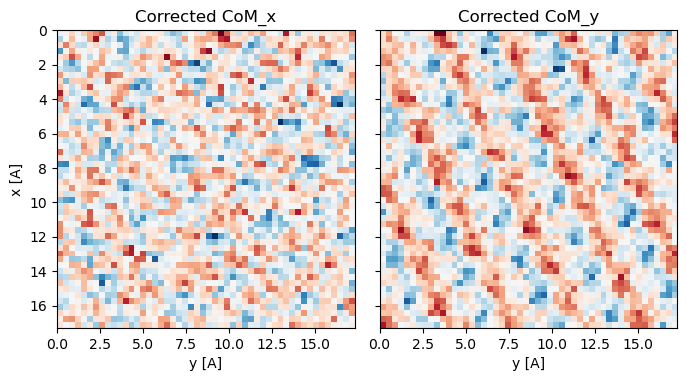

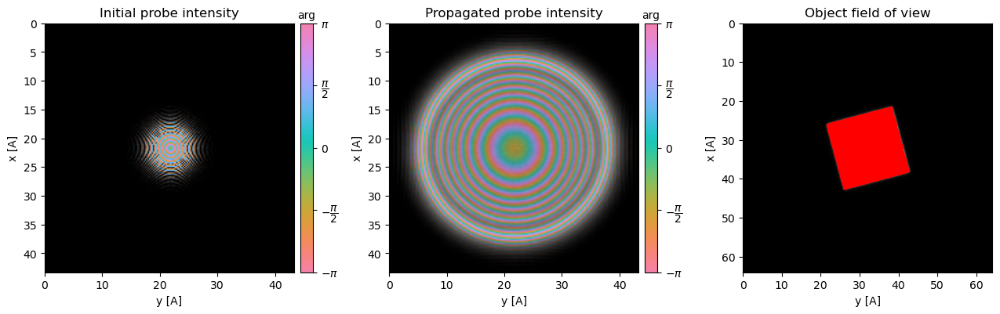

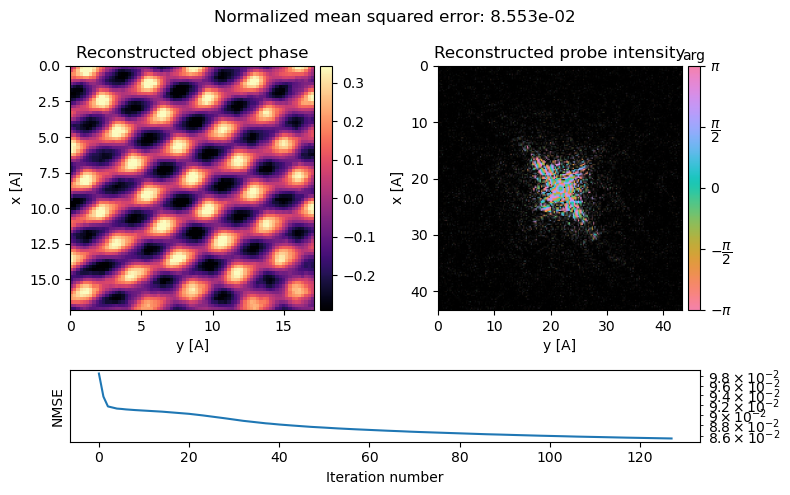

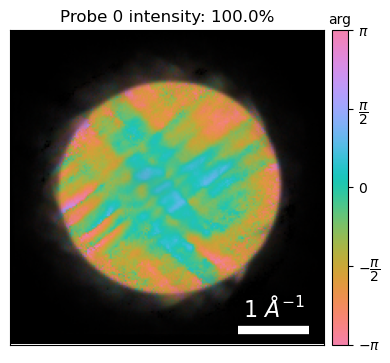

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 351.65probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:24<00:00,  1.52 iter/s]


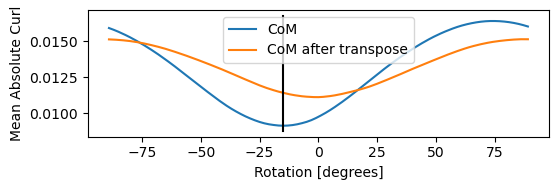

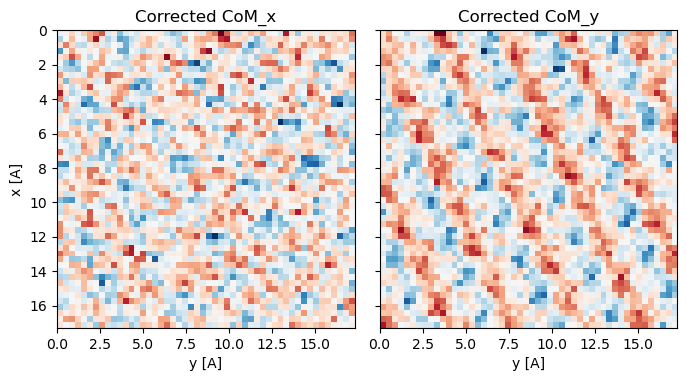

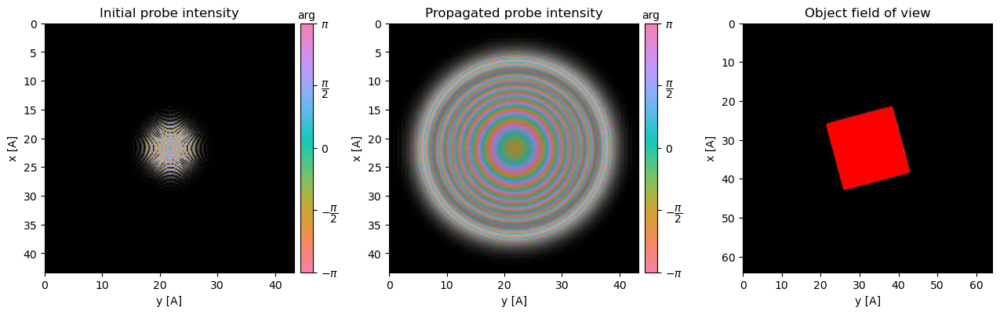

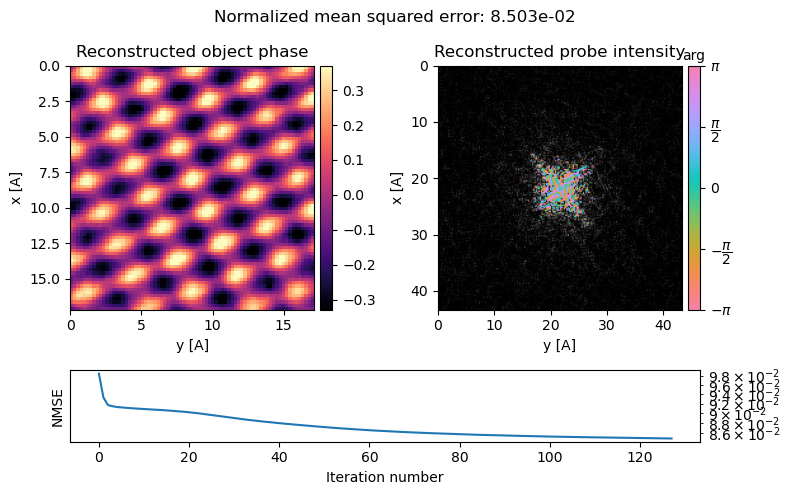

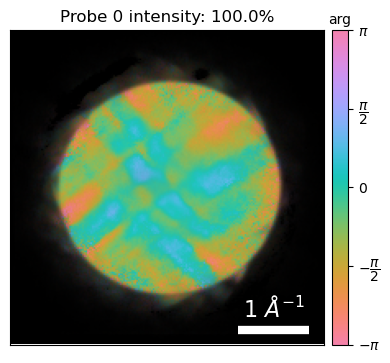

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 348.35probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:22<00:00,  1.54 iter/s]


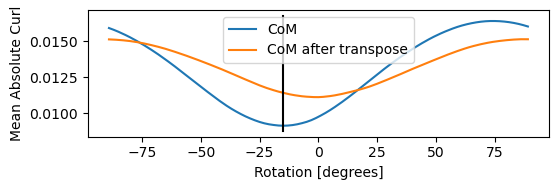

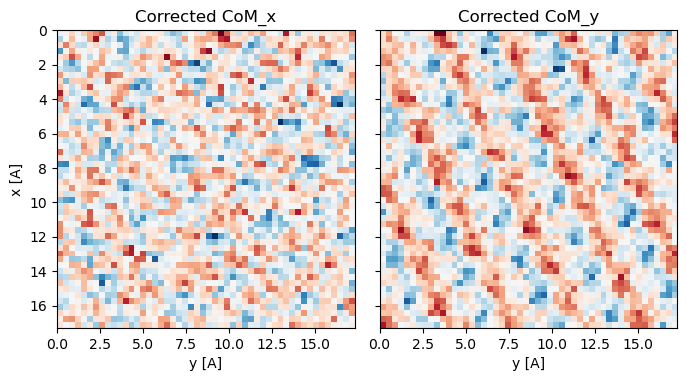

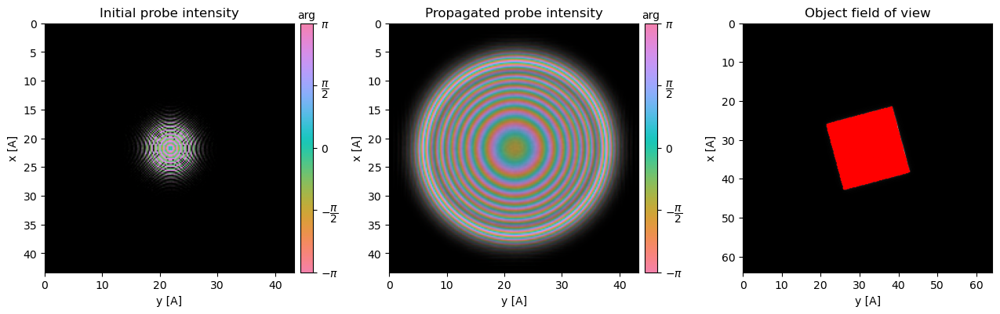

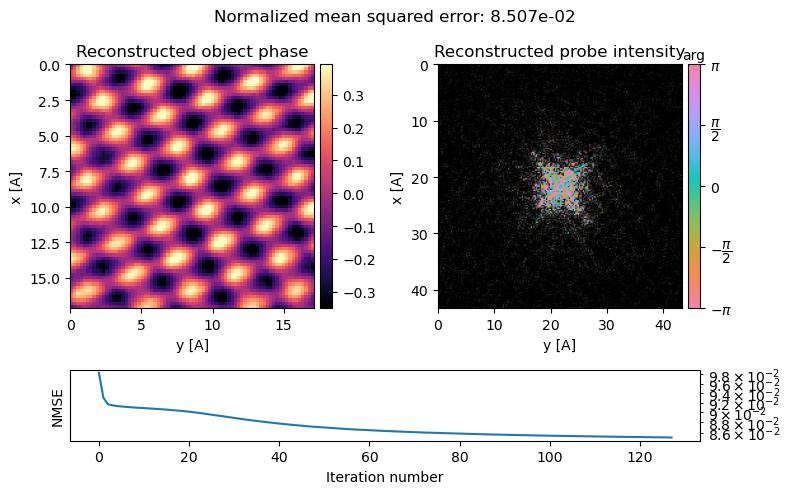

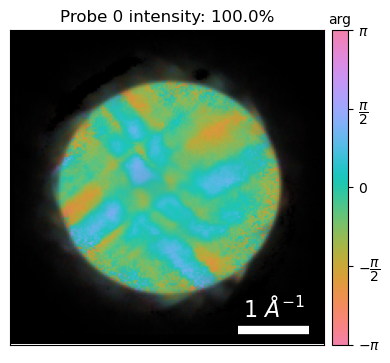

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 346.49probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:22<00:00,  1.54 iter/s]


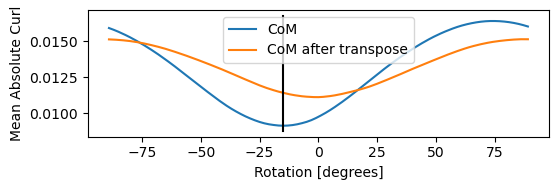

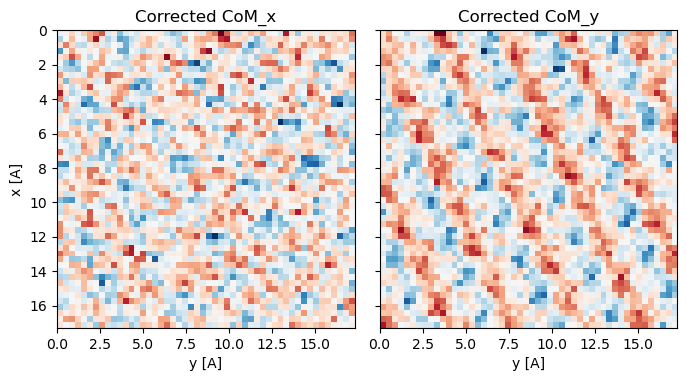

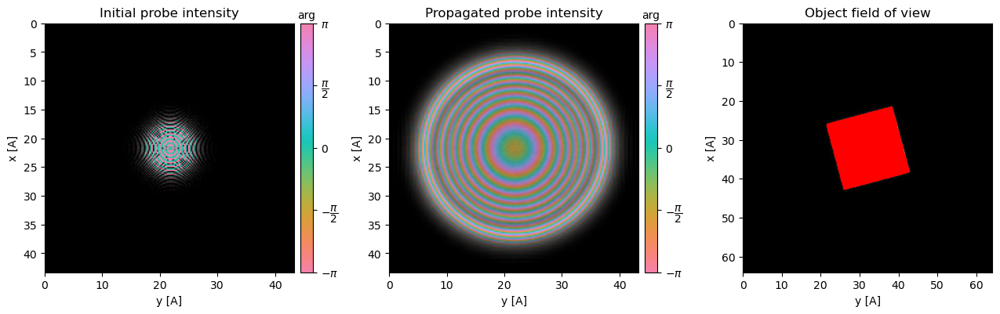

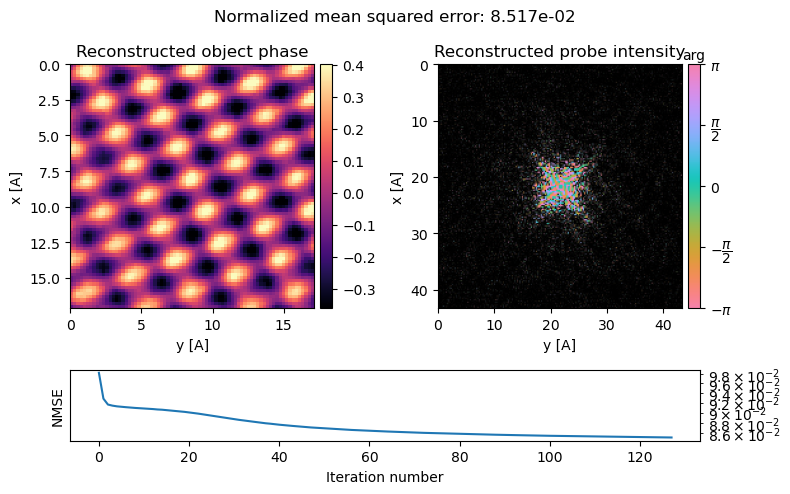

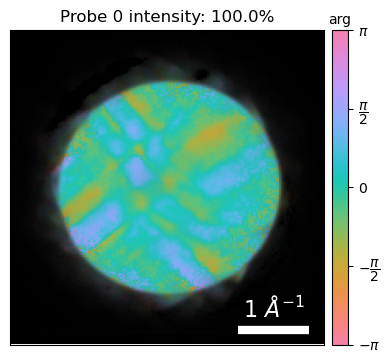

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 347.87probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:23<00:00,  1.54 iter/s]


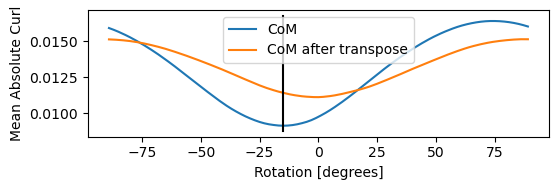

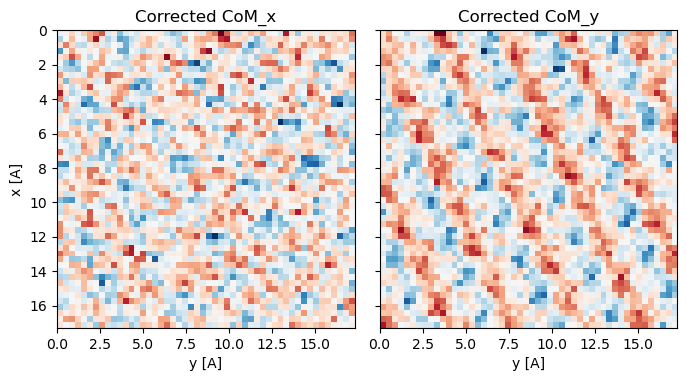

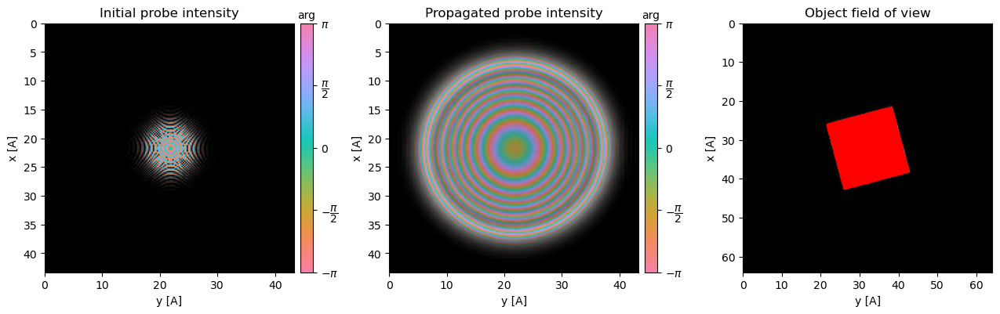

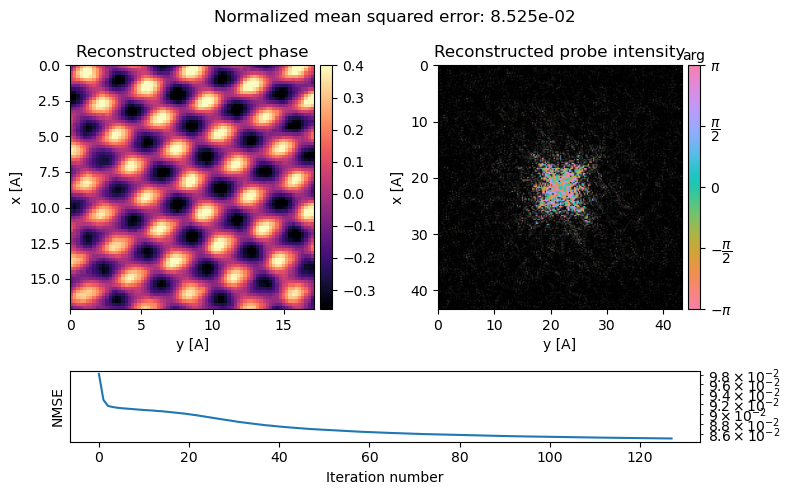

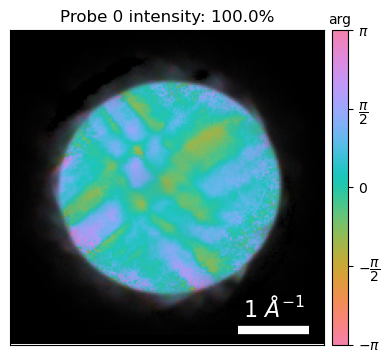

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 349.23probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:23<00:00,  1.54 iter/s]


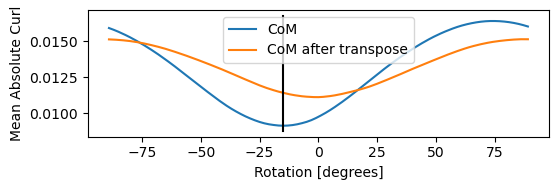

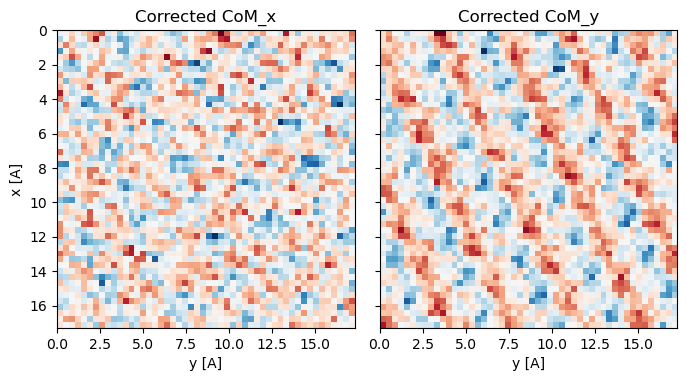

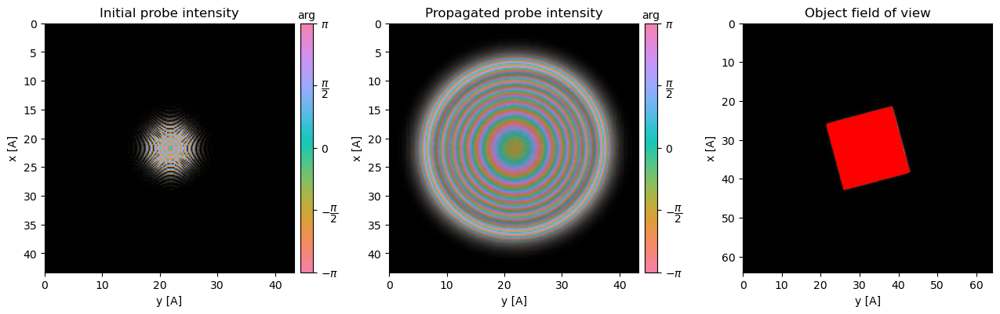

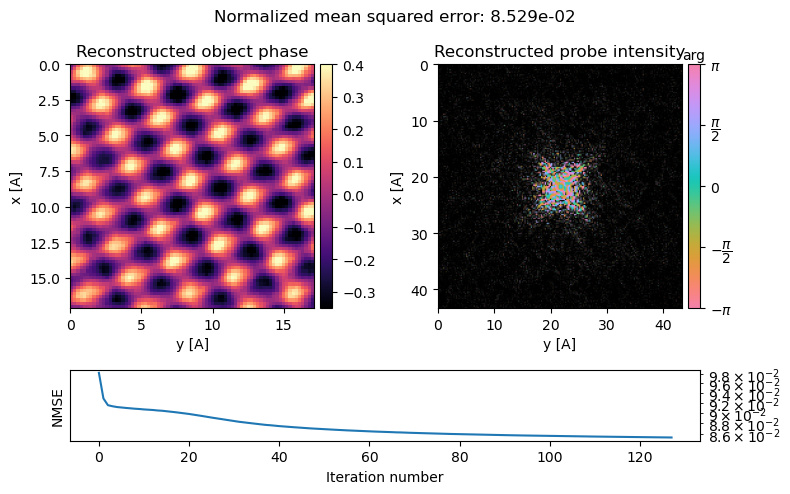

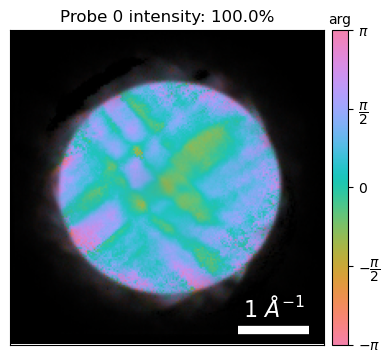

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 347.42probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:23<00:00,  1.54 iter/s]


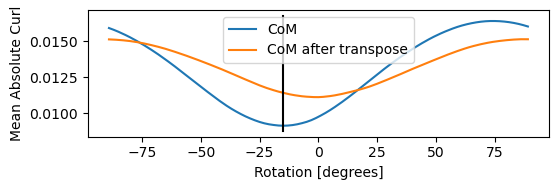

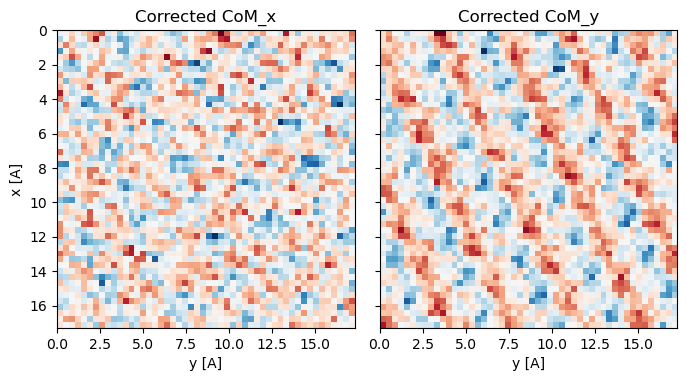

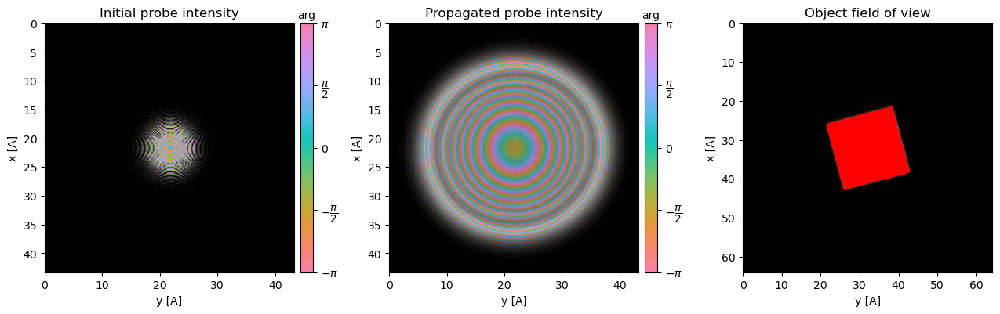

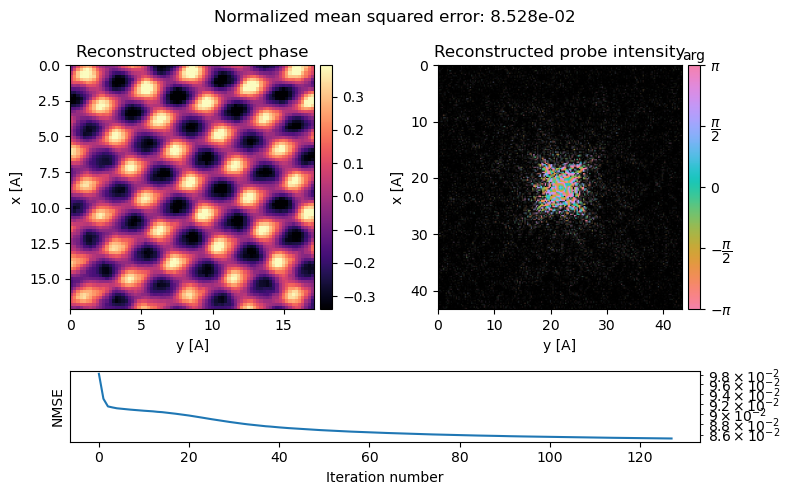

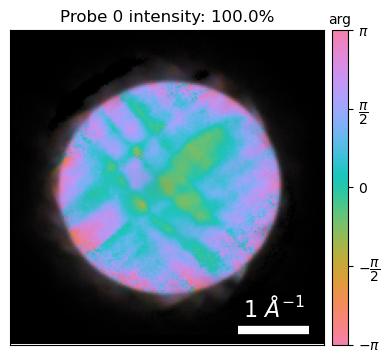

In [ ]:
ptychos_sweep_roll = []
ptychos_object = []
ptychos_object_fft = []

sweep_param = np.linspace(-15,15,7)
tot_thickness = 750

for roll in sweep_param:    
    ptycho1 = py4DSTEM.process.phase.MultislicePtychography(
        datacube=dataset,
        energy=300e3,
        defocus=roll,
        vacuum_probe_intensity=probe_nparray,
        verbose=True,
        device='gpu', # uncomment if you have access to a GPU
        storage='cpu', # uncomment if you have access to a GPU
        semiangle_cutoff = 30,
        num_slices=5,
        slice_thicknesses=150,
    )

    ptycho = ptycho1.preprocess(
        plot_rotation=True,
        plot_center_of_mass = True,
        plot_probe_overlaps = True,
        # vectorized_com_calculation = False, # disable default CoM vectorized calc
        # store_initial_arrays= False, # don't store arrays necessary for reset=True
        max_batch_size= 128, # set max batch size for GPU memory
        clear_fft_cache=True, # clear the FFT cache to free GPU memory
    )
    ptycho00 = ptycho.reconstruct(
        num_iter = 128,
        seed_random=0,
        max_batch_size=512,
        fix_probe = False,

    ).visualize(
    )
    ptycho.show_fourier_probe()

    ptychos_sweep_roll.append(ptycho00)

    ptychos_object.append(np.average(np.angle(ptycho00.object_cropped).copy(), axis = 0))
    ptychos_object_fft.append(ptycho00.object_fft)
    plt.show()

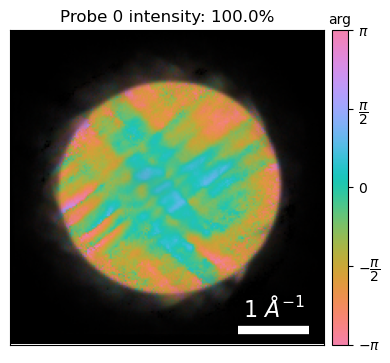

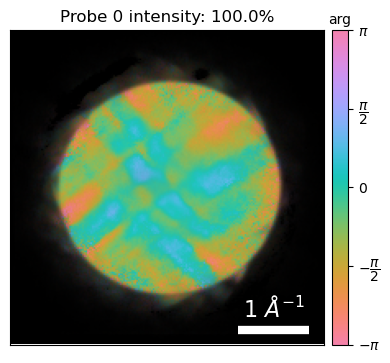

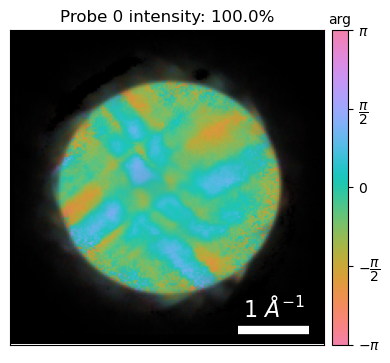

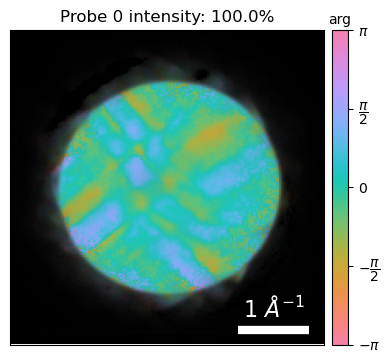

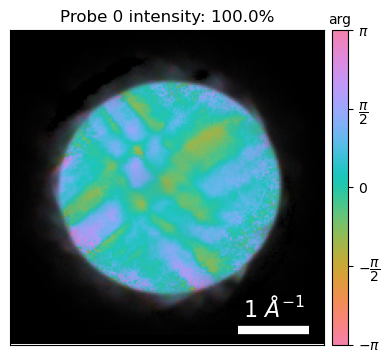

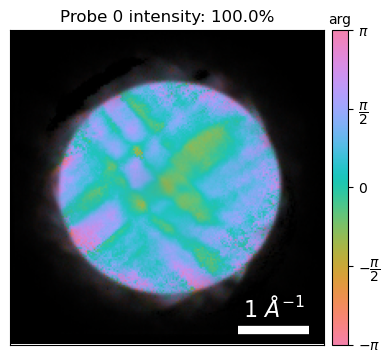

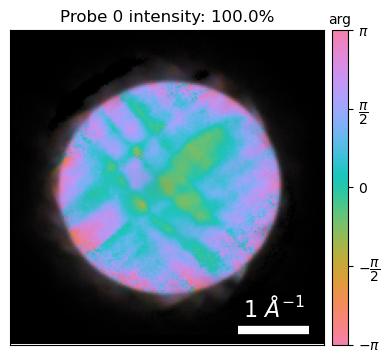

In [ ]:
probe_intensities = []
probe_images = []
for i, p in enumerate(ptychos_sweep_roll):
    probe_intensity = np.abs(p.probe.copy())
    probe_intensities.append(probe_intensity)

    p.show_fourier_probe()
    plt.savefig(f'test_probe{i}.png', dpi=300, bbox_inches='tight')

    probe_images.append(plt.imread(f'test_probe{i}.png'))

    # py4DSTEM.show(
    #     probe_intensity
    # )

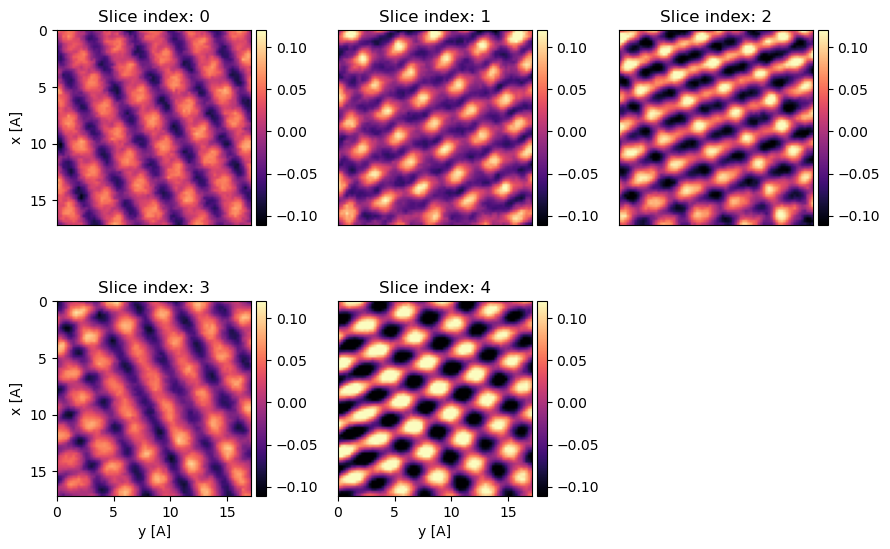

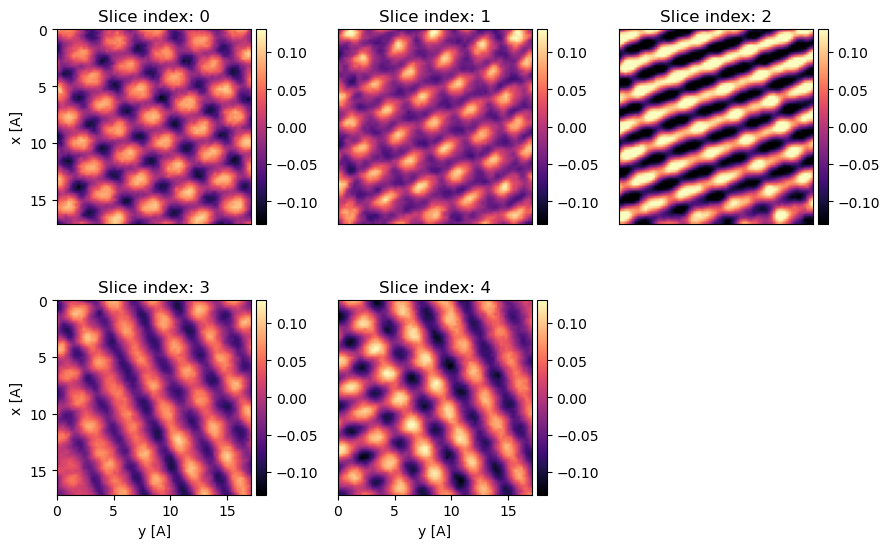

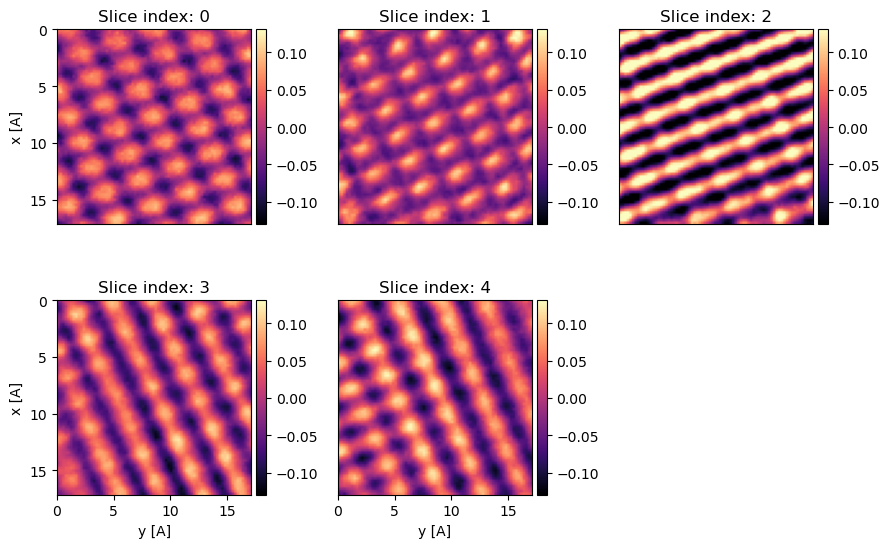

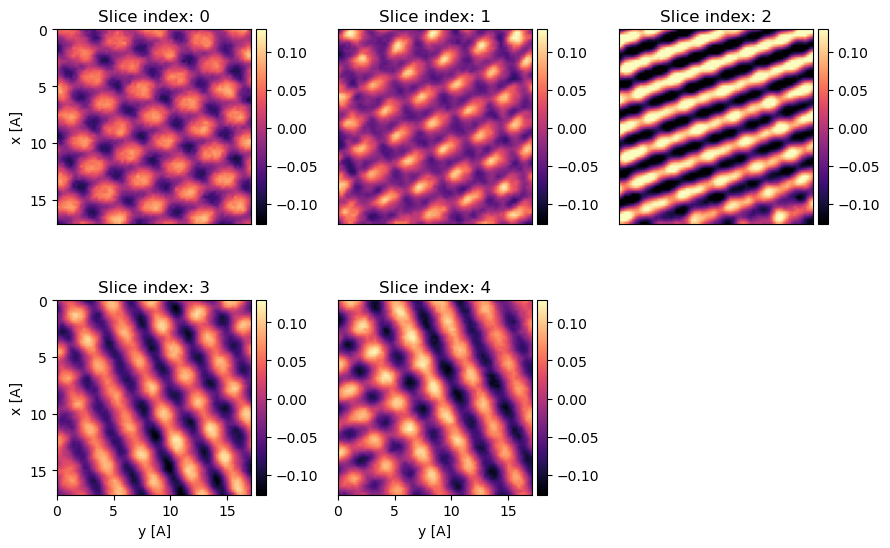

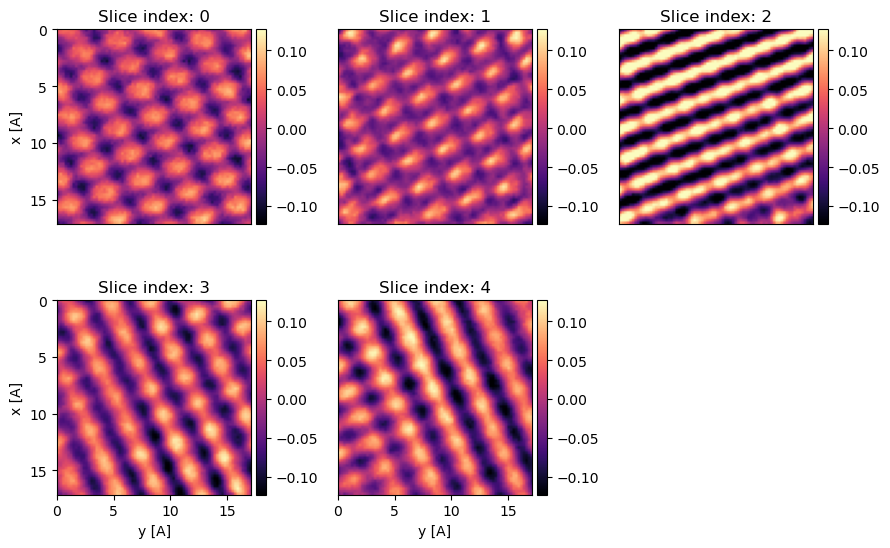

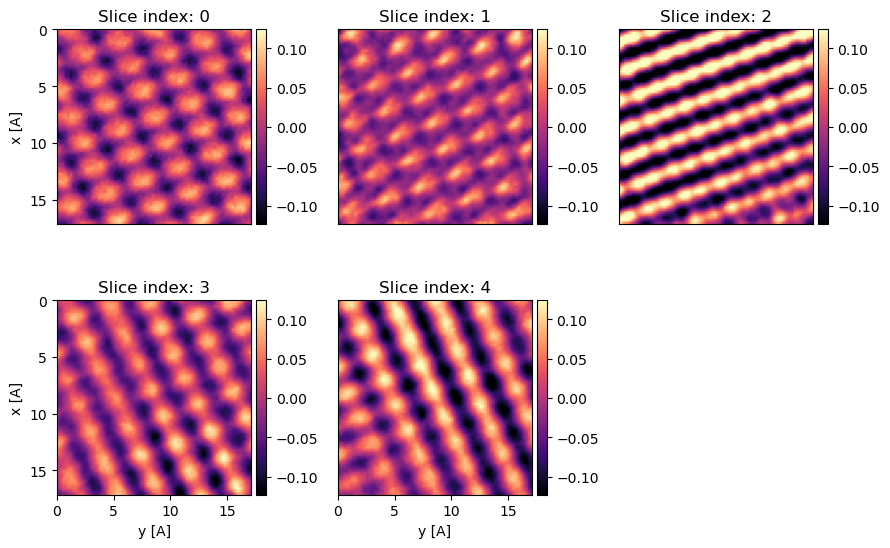

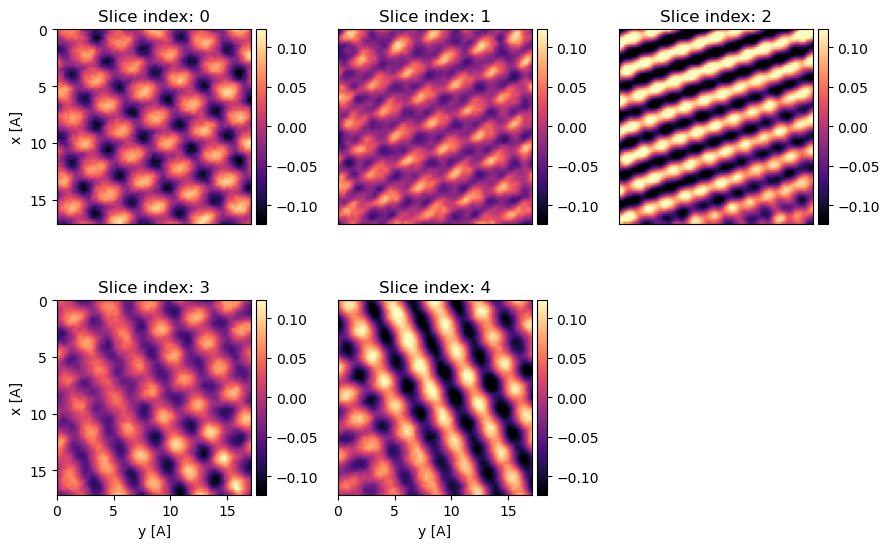

In [ ]:
for i,p in enumerate(ptychos_sweep_roll):
    p.show_slices()
    plt.savefig(f'test_5x150nm_multislice_{sweep_param[i]:.2f}nm_bigger_area.png', dpi=300, bbox_inches='tight')

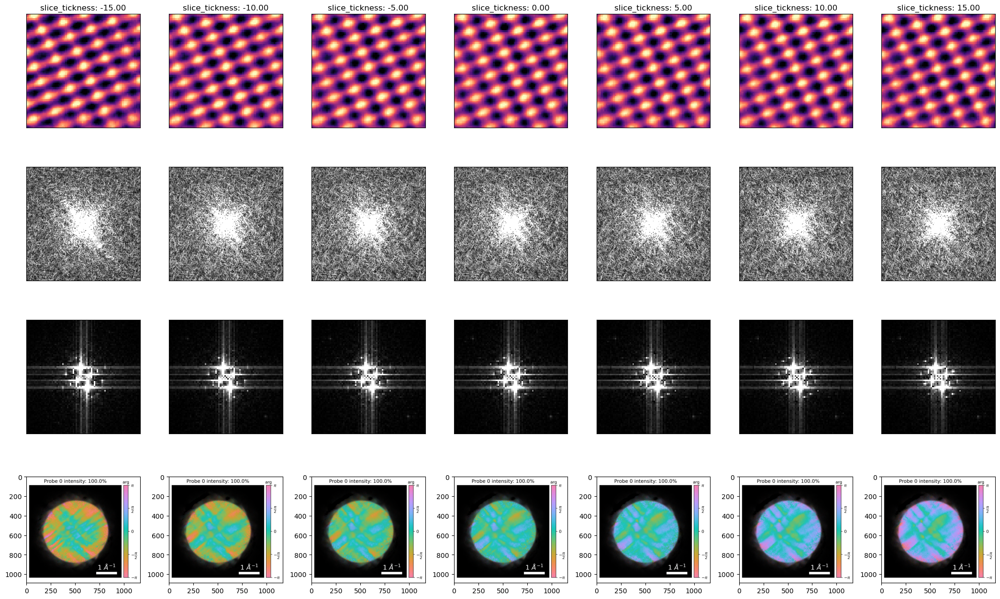

In [ ]:
fig, axs = plt.subplots(4,len(ptychos_object),figsize=(3.5*6,3.5*4))
sweep_param_name = 'slice_tickness'

titles = []
for i, roll in enumerate(sweep_param):
    titles.append(f"{sweep_param_name}: {roll:.2f}")

py4DSTEM.show(
    ptychos_object,
    ticks=False,
    figax=(fig,axs[0]),
    cmap='magma',
    title=titles,
)

py4DSTEM.show(
    probe_intensities,
    ticks=False,
    figax=(fig,axs[1]),
    vmin=0.001,
    vmax=0.899,
)
py4DSTEM.show(
    ptychos_object_fft,
    ticks=False,
    figax=(fig,axs[2]),
)

for i, ax in enumerate(axs[3]):
    ax.imshow(probe_images[i])

fig.tight_layout()
fig.savefig(f'C:\\github\\py4DSTEM_tutorials\\pictures\\ptycho_sweep_5x150nm_{sweep_param_name}_bigger_area.png', dpi=300, bbox_inches='tight')

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 351.05probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 1 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [2:40:03<00:00, 75.03s/ iter] 


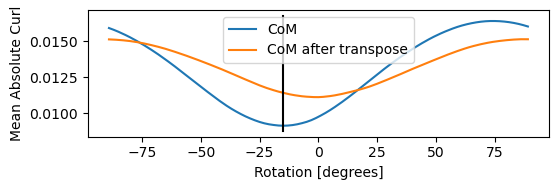

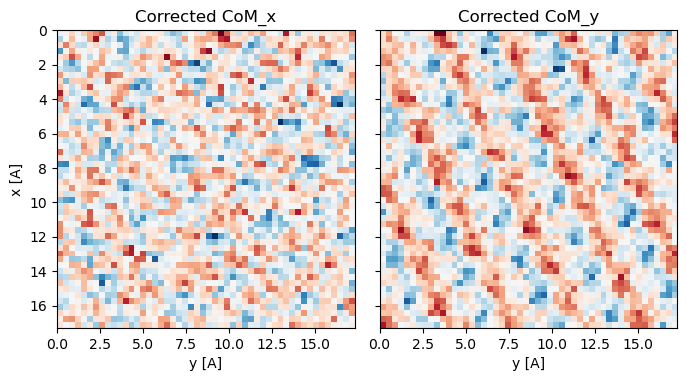

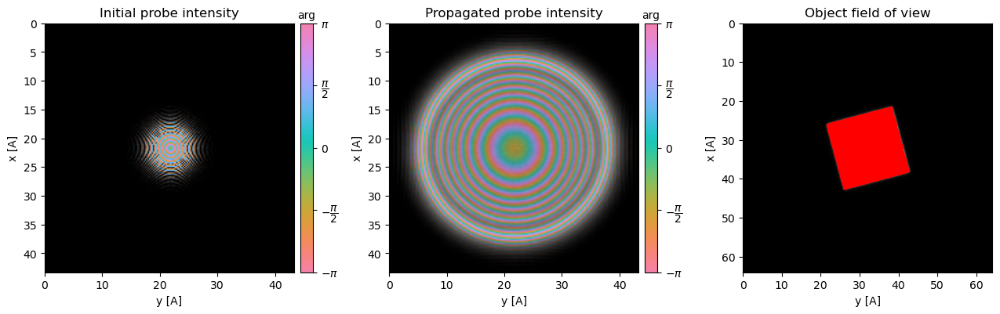

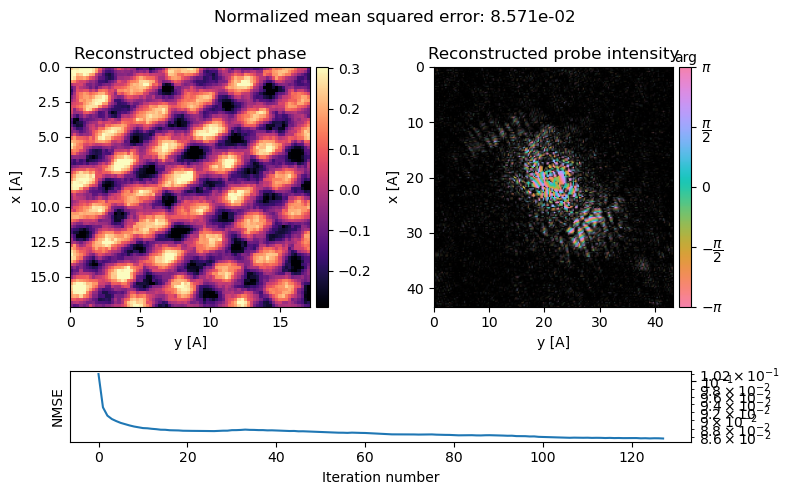

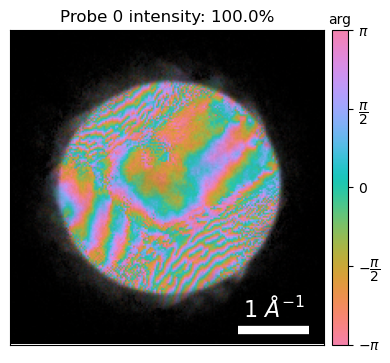

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 348.01probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 4 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [37:54<00:00, 17.77s/ iter]


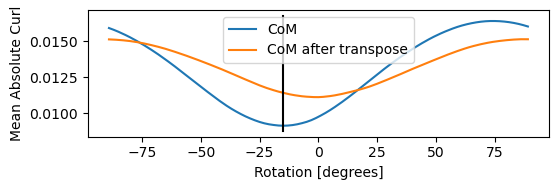

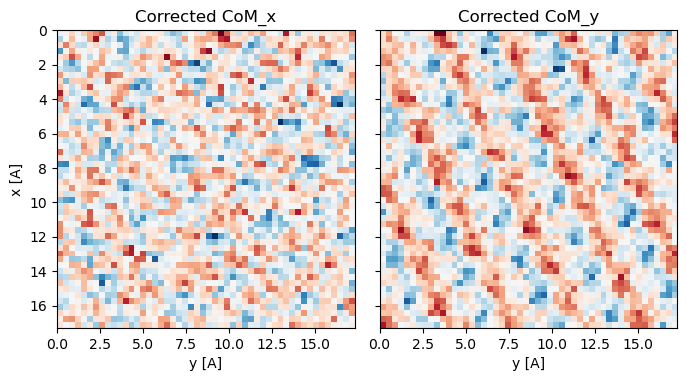

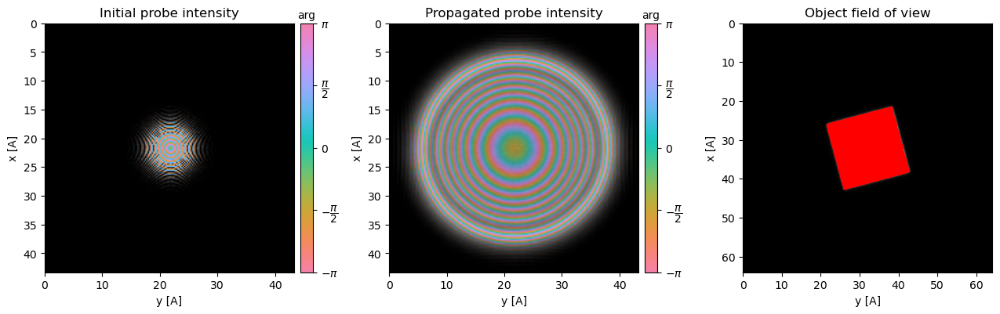

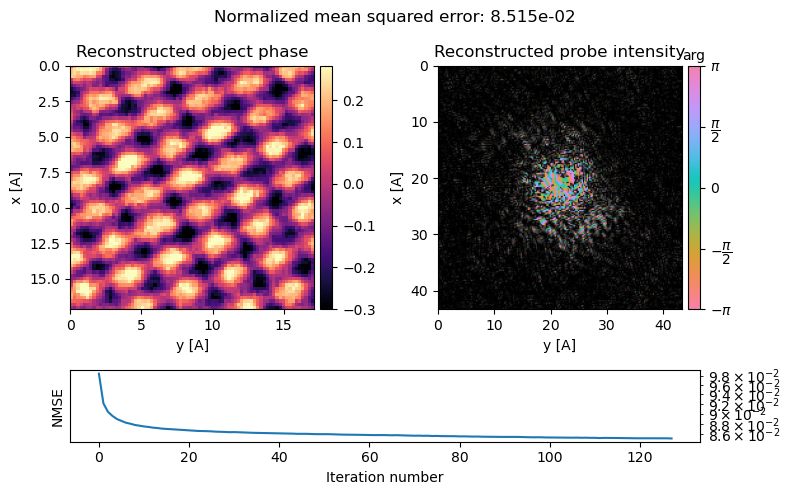

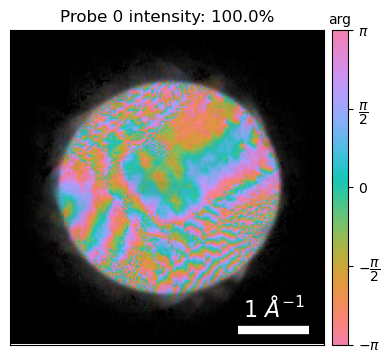

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 349.63probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 16 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [09:58<00:00,  4.68s/ iter]


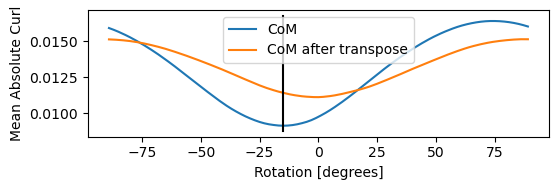

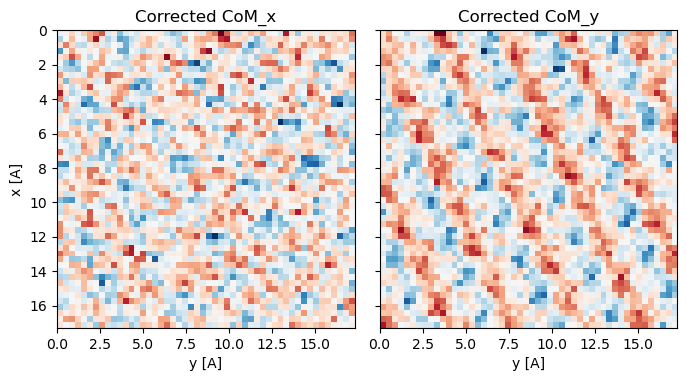

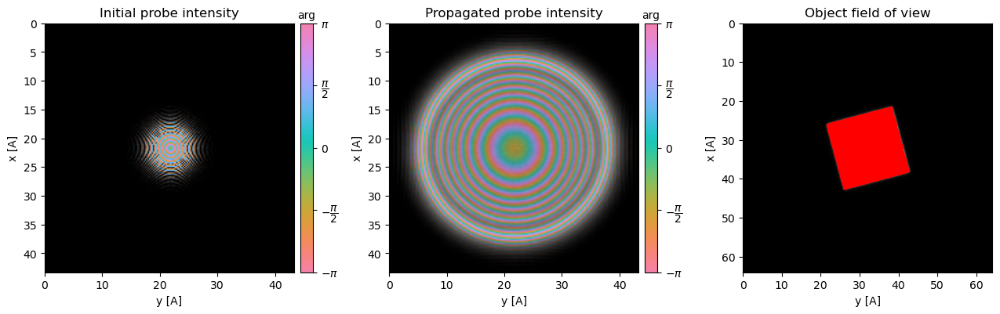

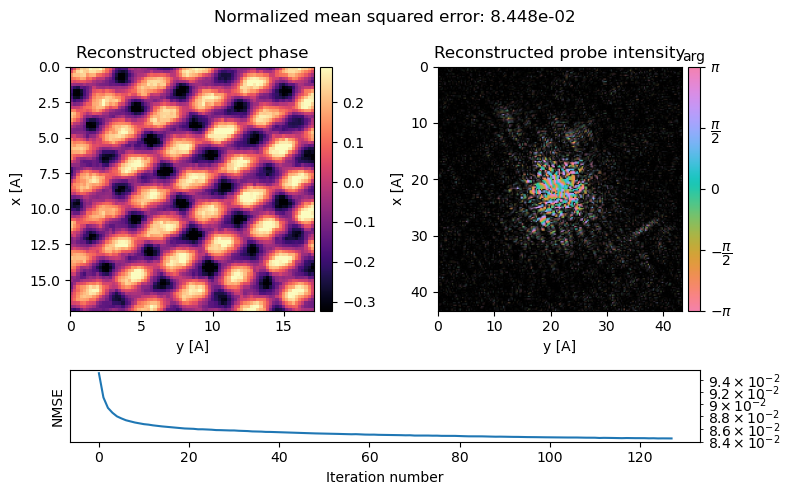

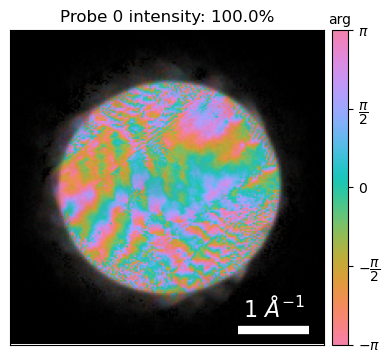

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 349.80probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 64 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [02:52<00:00,  1.35s/ iter]


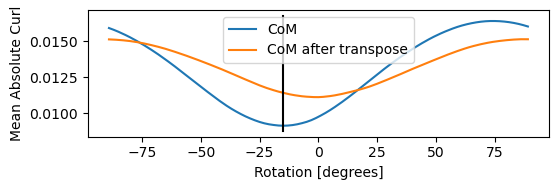

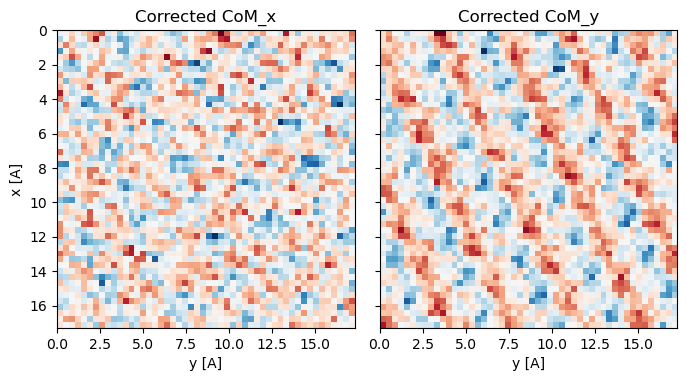

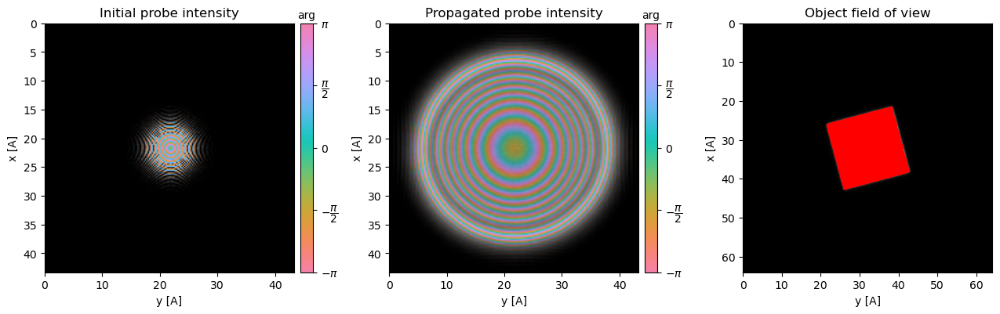

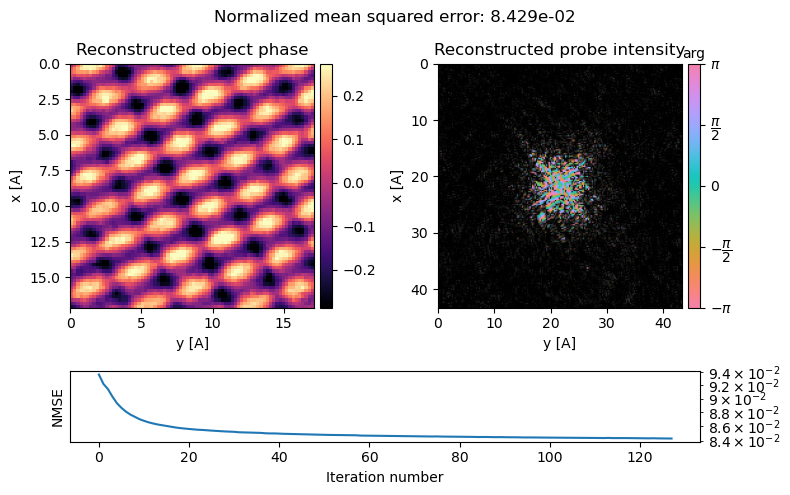

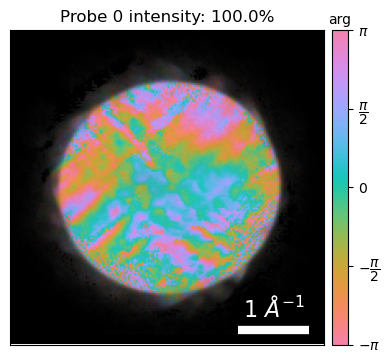

Best fit rotation = -15 degrees.
Normalizing amplitudes: 100%|██████████| 2500/2500 [00:07<00:00, 349.11probe position/s]
Performing 128 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 256 measurements.
Reconstructing object and probe: 100%|██████████| 128/128 [01:33<00:00,  1.36 iter/s]


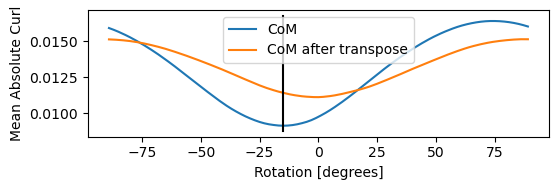

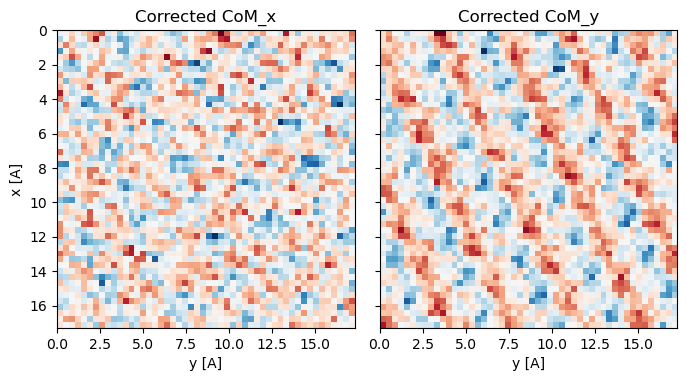

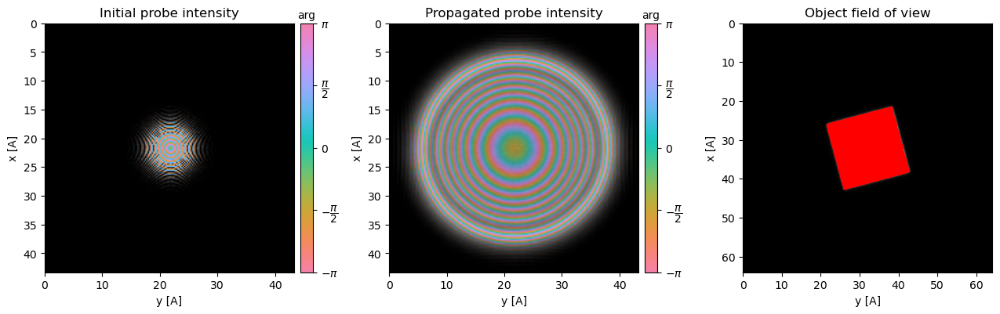

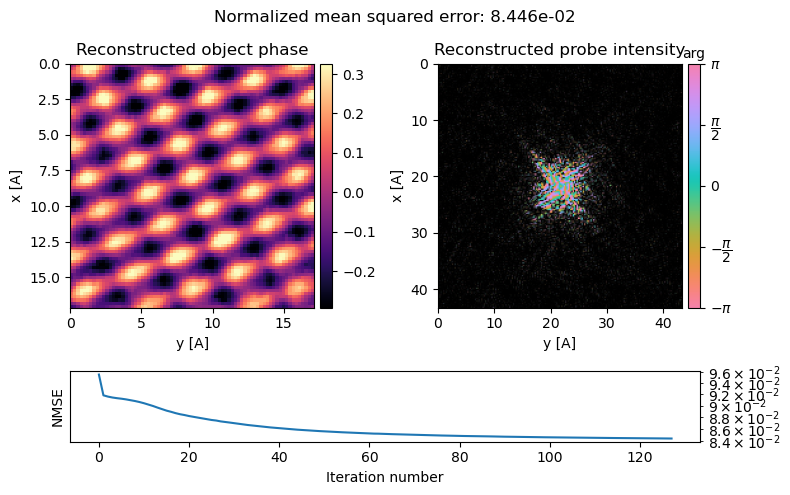

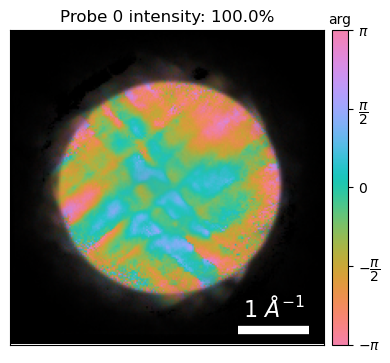

In [ ]:
mptychos_sweep_roll = []
mptychos_object = []
mptychos_object_fft = []
param_list = []

sweep_param = 2**(np.arange(0,5)*2)
tot_thickness = 750

for roll in sweep_param: 
    try:   
        ptycho1 = py4DSTEM.process.phase.MultislicePtychography(
            datacube=dataset,
            energy=300e3,
            defocus=-15,
            vacuum_probe_intensity=probe_nparray,
            verbose=True,
            device='gpu', # uncomment if you have access to a GPU
            storage='cpu', # uncomment if you have access to a GPU
            semiangle_cutoff = 30,
            num_slices=5,
            slice_thicknesses=150,
        )

        ptycho = ptycho1.preprocess(
            plot_rotation=True,
            plot_center_of_mass = True,
            plot_probe_overlaps = True,
            # vectorized_com_calculation = False, # disable default CoM vectorized calc
            # store_initial_arrays= False, # don't store arrays necessary for reset=True
            max_batch_size= roll, # set max batch size for GPU memory
            clear_fft_cache=True, # clear the FFT cache to free GPU memory
        )
        ptycho00 = ptycho.reconstruct(
            num_iter = 128,
            seed_random=0,
            max_batch_size=roll,
            fix_probe = False,

        ).visualize(
        )
        ptycho.show_fourier_probe()

        ptychos_sweep_roll.append(ptycho00)

        ptychos_object.append(np.average(np.angle(ptycho00.object_cropped).copy(), axis = 0))
        ptychos_object_fft.append(ptycho00.object_fft)
        param_list.append(roll)
        plt.show()
    except Exception as e:
        print(f"Error with {roll}: {e}")
        continue


Calculating center of mass: 100%|██████████| 65536/65536 [00:19<00:00, 3340.40probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:05<00:00, 354.13probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [15:31<00:00, 14.55s/ iter]


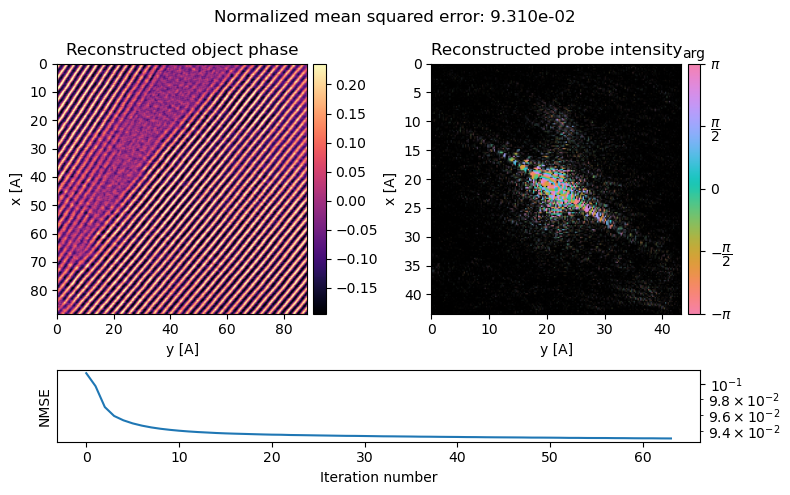

In [ ]:
mptycho_01 = py4DSTEM.process.phase.MultislicePtychography(
    energy=300e3,
    num_slices=4,
    semiangle_cutoff = 200,
    slice_thicknesses=20,
    datacube=dataset_masked,
    defocus=0,
    vacuum_probe_intensity=probe_nparray*10,
    verbose=True,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
)

mptycho = mptycho_01.preprocess(
    plot_center_of_mass = False,
    plot_rotation=False,
    plot_probe_overlaps=False,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
).reconstruct(
    num_iter = 64,
    seed_random=0,
    max_batch_size=512,
).visualize(
)


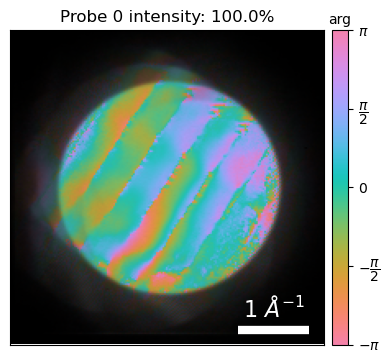

In [ ]:
mptycho.show_fourier_probe()

In [ ]:
ptycho_01_mixed = py4DSTEM.process.phase.MixedstatePtychography(
    datacube=dataset_masked,
    energy=300e3,
    defocus=0,
    vacuum_probe_intensity= probe_nparray,
    verbose=True,
    num_probes=2,
    device='gpu', # uncomment if you have access to a GPU
    storage='cpu', # uncomment if you have access to a GPU
    semiangle_cutoff=30,
)


Calculating center of mass: 100%|██████████| 65536/65536 [00:21<00:00, 3052.07probe position/s]
Best fit rotation = -4 degrees.
Normalizing amplitudes: 100%|██████████| 65536/65536 [03:07<00:00, 349.51probe position/s]
Performing 64 iterations using a complex object type, with the gradient-descent algorithm, with normalization_min: 1 and step_size: 0.5, in batches of max 512 measurements.
Reconstructing object and probe: 100%|██████████| 64/64 [09:38<00:00,  9.04s/ iter]


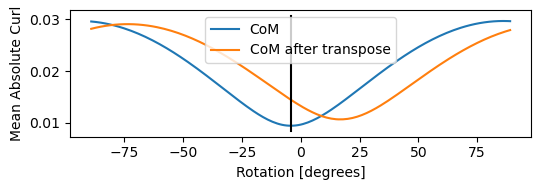

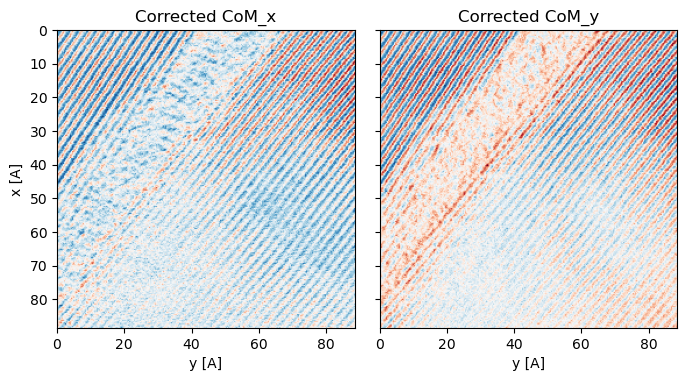

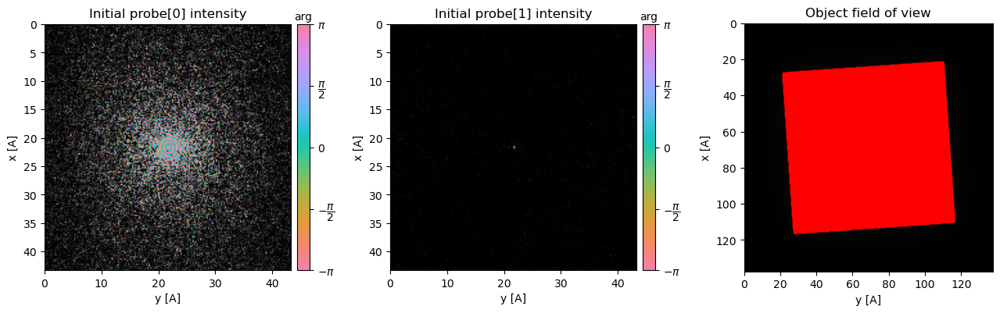

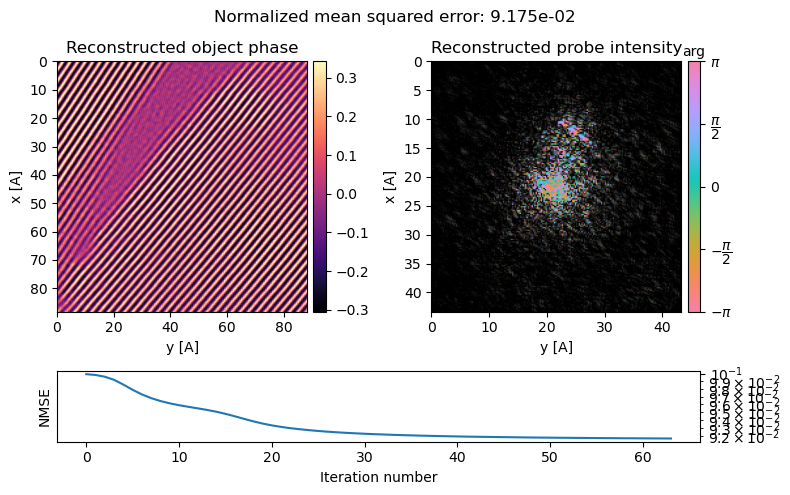

In [ ]:
ptycho_mixed = ptycho_01_mixed.preprocess(
    plot_center_of_mass = True,
    plot_rotation=True,
    plot_probe_overlaps=True,
    vectorized_com_calculation = False, # disable default CoM vectorized calc
    store_initial_arrays= False, # don't store arrays necessary for reset=True
    max_batch_size= 128, # set max batch size for GPU memory
)

ptycho_mixed_00 = ptycho_mixed.reconstruct(
    num_iter = 64,
    seed_random=2024,
    max_batch_size=512,
).visualize(
)

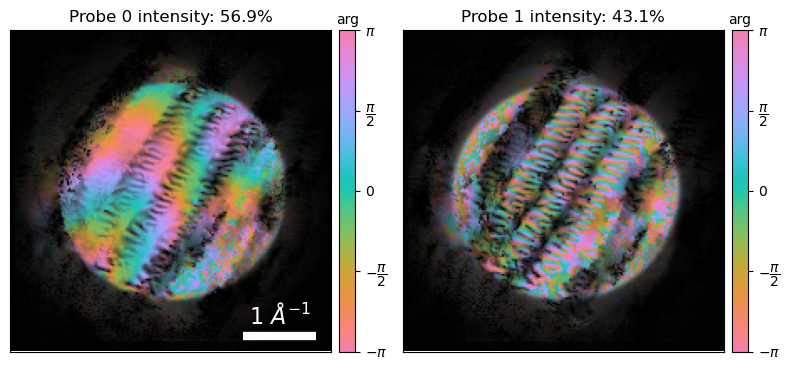

In [ ]:
ptycho_mixed.show_fourier_probe()

## Grid-search
The simplest optimization is to perform a grid-search. This ignores the `initial_value` argument of `OptimizationParameter` and instead evaluates the ptychography model using equally-distributed `n_points` between the `lower_bound` and `upper_bound`.

In [101]:
from py4DSTEM.process.phase.parameter_optimize import OptimizationParameter, PtychographyOptimizer

init_args = {
    'datacube':dataset,
    'energy':300e3,
    'vacuum_probe_intensity':probe.data,
    'device':'gpu',
    'storage':'cpu',
    'defocus': OptimizationParameter(0,-100, 100), # defocus in A
    'num_slices':5,
    'slice_thicknesses': 250, #59.571678348419034, # slice thickness in A
    'middle_focus':True,
}

preprocess_args = {
    # 'force_reciprocal_sampling':0.25,
    'force_com_rotation': -3.0242154298646735,
    'force_com_transpose': False,
    'vectorized_com_calculation' : False, # disable default CoM vectorized calc
    # 'store_initial_arrays' : False, # don't store arrays necessary for reset=True
}

recon_args = {
    'num_iter':128,
    'max_batch_size':512,
}

optimizer = PtychographyOptimizer(
    py4DSTEM.process.phase.MultislicePtychography,
    init_args = init_args,
    preprocess_args = preprocess_args,
    reconstruction_args = recon_args,
)

Searching parameters: 100%|██████████| 5/5 [05:06<00:00, 61.23s/it]


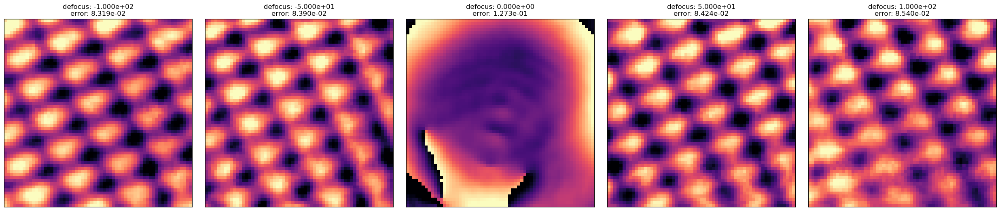

In [104]:
objects = optimizer.grid_search(
    n_points=(5,),
    error_metric="linear",
    plot_reconstructed_objects=True,
    # return_reconstructed_objects=False,
    return_reconstructed_objects = True,
    plot_reconstructed_objects_fft=False,
    figsize=(25,10),
    ncols = 5,
)
plt.savefig('..\\pictures\\' +now_str()+ 'multiptycho_grid_search_rot.png', dpi=300, bbox_inches='tight')

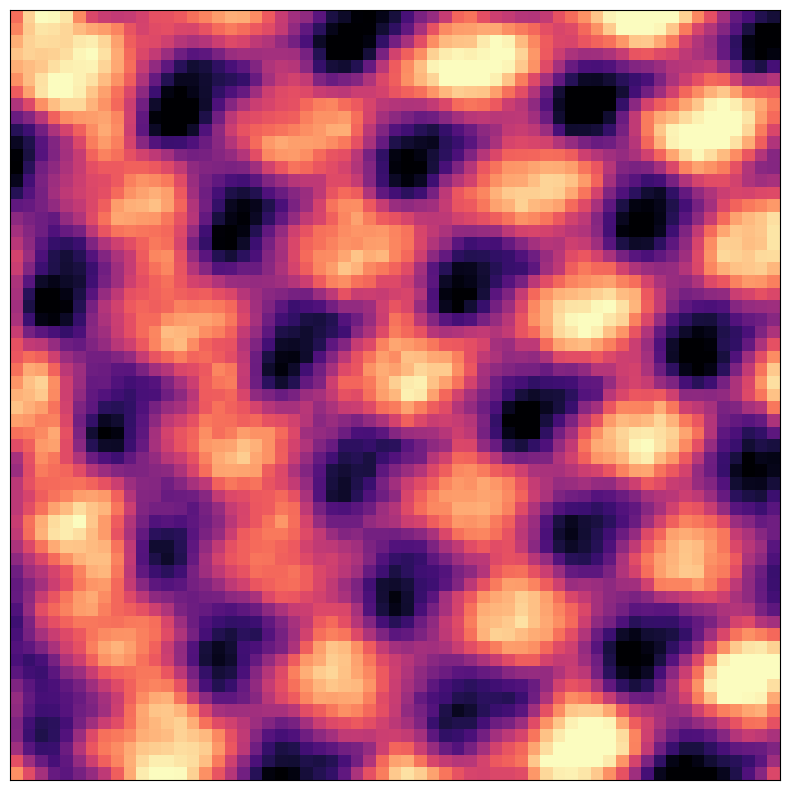

In [54]:
py4DSTEM.show(
    objects[0][0],
    cmap='magma',
    ticks=False,
    figsize=(25,8),
)

## Bayesian-Optimization with Gaussian Processes

Alternatively, we can perform a more efficient search using Bayesian optimization with Gaussian processes (as implemented in [scikit-optimize](https://scikit-optimize.github.io/stable/)).

Optimizing parameters: 100%|██████████| 30/30 [30:52<00:00, 61.76s/it]

Optimized parameters:
defocus: -92.9143842014694


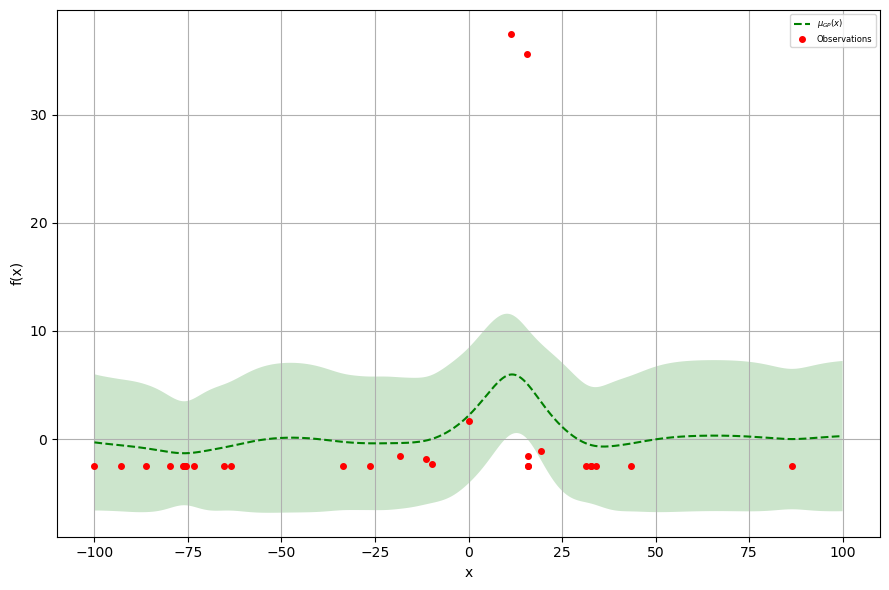

In [105]:
optimizer.optimize(
    n_calls=30,
    n_initial_points=15,
    error_metric='log',
)
optimizer = optimizer.visualize()
plt.savefig('..\\pictures\\' +now_str()+ 'multiptycho_grid_search_slice_thickness.png', dpi=300, bbox_inches='tight')

We can also optimize more than one parameters at a time (although note this is not always advisable).  
Here, we optimize defocus and rotation jointly and plot the partial dependence of each parameter on the error metric.

In [106]:
# Replace/add Optimization parameters in the argument dictionaries
preprocess_args.pop('slice_thickness',50)
# preprocess_args['slice_thicknesses'] = 41
init_args['defocus']=OptimizationParameter(-110,-300,175)
preprocess_args['force_com_rotation']=OptimizationParameter(7,-15,30)

optimizer_defocus_thickness = PtychographyOptimizer(
    py4DSTEM.process.phase.MultislicePtychography,
    init_args = init_args,
    preprocess_args = preprocess_args,
    reconstruction_args = recon_args,
)

optimizer_defocus_thickness.optimize(
    n_calls=80,
    n_initial_points=15,
    error_metric='log',
)
optimizer_defocus_thickness = optimizer_defocus_thickness.visualize()
plt.savefig('..\\pictures\\' +now_str()+ 'multiptycho_grid_search_slice_defoc_rot.png', dpi=300, bbox_inches='tight')

Optimizing parameters:  39%|███▉      | 31/80 [32:41<51:40, 63.28s/it]  


ValueError: Input y contains NaN.

sometimes the reconstruction will not converge and will give errors. Never got as far as 2D optimization...

In [ ]:
# Replace/add Optimization parameters in the argument dictionaries
# preprocess_args.pop('force_reciprocal_sampling',None)
# preprocess_args['slice_thicknesses'] = 41
preprocess_args.pop('defocus',-110)
preprocess_args.pop('force_com_rotation',-15)
init_args['slice_thickness']=OptimizationParameter(-110,-300,175)
preprocess_args['num_slices'] = OptimizationParameter(5,2,10)

optimizer_defocus_rotation = PtychographyOptimizer(
    py4DSTEM.process.phase.MultislicePtychography,
    init_args = init_args,
    preprocess_args = preprocess_args,
    reconstruction_args = recon_args,
)

optimizer_defocus_rotation.optimize(
    n_calls=80,
    n_initial_points=15,
    error_metric='log',
)
optimizer_defocus_rotation = optimizer_defocus_rotation.visualize()
plt.savefig('..\\pictures\\' +now_str()+ 'multiptycho_grid_search_slice_rot_thickness.png', dpi=300, bbox_inches='tight')